In [86]:
import pdfplumber
import pandas as pd
import pydantic
from __future__ import annotations
from typing import List, Union, Literal, Optional
from datetime import datetime
from pydantic import BaseModel, Field, root_validator, validator, constr, conlist

class AmountRange(BaseModel):
    from_: float = Field(
        ...,
        alias="from",
        ge=0,
        description="Inclusive lower bound of the transaction amount in EUR."
    )
    to: float = Field(
        ...,
        ge=0,
        description="Inclusive upper bound of the transaction amount in EUR."
    )

    @validator("to")
    def to_must_be_ge_from(cls, v: float, values):
        if "from_" in values and v < values["from_"]:
            raise ValueError("'to' must be greater than or equal to 'from'")
        return v

    class Config:
        allow_population_by_field_name = True

class FeeRule(BaseModel):
    range: AmountRange = Field(..., description="Amount slab to which this rule applies")
    feeType: Literal["fixed", "percentage", "minmax", "waived", "variable"] = Field(
        ..., description="Charging method"
    )
    fixedFee: Optional[float] = Field(
        None, ge=0, description="Flat fee amount in EUR"
    )
    percentage: Optional[float] = Field(
        None, ge=0, le=100, description="Percentage rate (e.g. 0.10 for 0.10%)"
    )
    minFee: Optional[float] = Field(
        None, ge=0, description="Minimum fee in EUR (for 'minmax')"
    )
    maxFee: Optional[float] = Field(
        None, ge=0, description="Maximum fee in EUR (for 'minmax')"
    )
    currency: Literal["EUR"] = Field(
        "EUR", description="Currency code for all monetary fields"
    )
    note: Optional[str] = Field(
        None, description="Override text or annotation (e.g. 'Ανέξοδα', 'Πάγιο')"
    )

    @root_validator(skip_on_failure=True)
    def enforce_fee_fields(cls, values):
        ft = values.get("feeType")
        fixed = values.get("fixedFee")
        pct = values.get("percentage")
        mn = values.get("minFee")
        mx = values.get("maxFee")
        note = values.get("note")

        if ft == "fixed":
            if fixed is None:
                raise ValueError("fixedFee must be set when feeType is 'fixed'")
        elif ft == "percentage":
            if pct is None:
                raise ValueError("percentage must be set when feeType is 'percentage'")
        elif ft == "minmax":
            if pct is None or mn is None or mx is None:
                raise ValueError("percentage, minFee, and maxFee must be set when feeType is 'minmax'")
        elif ft in ("waived", "variable"):
            if not note:
                raise ValueError("note must be set when feeType is 'waived' or 'variable'")
        return values


class Channel(BaseModel):
    name: str = Field(..., description="Name of the channel (e.g. 'Branch')")
    fees: conlist(FeeRule, min_length=1) = Field(
        ..., description="List of fee rules for this channel"
    )


class FlatFees(BaseModel):
    fees: conlist(FeeRule, min_length=1) = Field(
        ..., description="List of fees that apply uniformly, possibly tiered by amount"
    )


class ChannelFees(BaseModel):
    channels: conlist(Channel, min_length=1) = Field(
        ..., description="Breakdown of fees by delivery channel"
    )


class ServiceEntry(BaseModel):
    code: constr(pattern=r"^[0-9]+(?:\.[0-9]+)*$") = Field(
        ..., description="Service code, including sub-codes (e.g. '2.1.1')"
    )
    description: str = Field(..., description="Detailed description of the service")
    feeModel: Union[FlatFees, ChannelFees] = Field(
        ..., description="Either a flat fee structure or per-channel breakdown"
    )
    notes: List[str] = Field(
        default_factory=list, description="Supplementary remarks or footnotes"
    )


class Category(BaseModel):
    code: constr(pattern=r"^[Α-Ω]+(?:\s*[:\-]\s*[Α-Ω]+)?$") = Field(
        ..., description="Category code or label (e.g. 'Α', 'Θ')"
    )
    title: str = Field(..., description="Human-readable heading of this category")
    services: conlist(ServiceEntry, min_length=1) = Field(
        ..., description="List of all service entries under this category"
    )
class BankFeeSchedule(BaseModel):
    bankName: str = Field(..., min_length=1, description="Full name of the bank")
    lastUpdated: datetime = Field(
        ..., description="Date when this fee schedule was last revised (YYYY-MM-DD)"
    )
    categories: conlist(Category, min_length=1) = Field(
        ..., description="Top-level sections of the fee schedule"
    )

def extract_raw_data_from_pdf(pdf_path):
    all_tables = []
    with pdfplumber.open(pdf_path) as pdf:
        # Extract bank name and effective date (heuristic)
        first_page_text = pdf.pages[0].extract_text()
        # You'll need logic here to find the bank name and date
        bank_name = "Unknown Bank" # e.g., find_bank_name(first_page_text)
        effective_date = "YYYY-MM-DD" # e.g., find_effective_date(first_page_text)

        for i, page in enumerate(pdf.pages[11:12]):
            print("#### page")
            # Primary method: extract tables directly
            tables = page.extract_tables()
            for table in tables:
                print("#### table")
                # Print as markdown table
                df = pd.DataFrame(table[1:], columns=table[0])
                display(df)
                # Clean up None values and newlines
                clean_table = [[cell.replace('\n', ' ') if cell is not None else '' for cell in row] for row in table]
                all_tables.append({
                    "bank": bank_name,
                    "date": effective_date,
                    "page": i + 1,
                    "data": pd.DataFrame(clean_table[1:], columns=clean_table[0]) # Assuming first row is header
                })
    return all_tables

# You would run this for each PDF.
raw_data = extract_raw_data_from_pdf('alpha.pdf')


#### page
#### table


/var/folders/s8/v2197cjs6xb3vy_flg5197z40000gn/T/ipykernel_57247/1734884484.py:22: PydanticDeprecatedSince20: Pydantic V1 style `@validator` validators are deprecated. You should migrate to Pydantic V2 style `@field_validator` validators, see the migration guide for more details. Deprecated in Pydantic V2.0 to be removed in V3.0. See Pydantic V2 Migration Guide at https://errors.pydantic.dev/2.11/migration/
  @validator("to")
/Users/iwa/.asdf/installs/python/3.13.3/lib/python3.13/site-packages/pydantic/_internal/_config.py:373: UserWarning: Valid config keys have changed in V2:
* 'allow_population_by_field_name' has been renamed to 'validate_by_name'
  warnings.warn(message, UserWarning)
/var/folders/s8/v2197cjs6xb3vy_flg5197z40000gn/T/ipykernel_57247/1734884484.py:55: PydanticDeprecatedSince20: Pydantic V1 style `@root_validator` validators are deprecated. You should migrate to Pydantic V2 style `@model_validator` validators, see the migration guide for more details. Deprecated in Pyd

,ΚΩΔ.,ΕΙΔΟΣ ΥΠΗΡΕΣΙΑΣ,None,None,ΠΟΣΟΣΤΟ\nΠΡΟΜΗΘΕΙΑΣ,,ΕΛΑΧΙΣΤΟ,,,ΜΕΓΙΣΤΟ,,ΠΑΡΑΤΗΡΗΣΕΙΣ
0,None,None,None,None,None,None,ΠΟΣΟ ΣΕ,None,None,ΠΟΣΟ ΣΕ,None,None
1,None,None,None,None,None,None,ΕΥΡΩ,None,None,ΕΥΡΩ,None,None
2,8,,ΥΠΗΡΕΣΙΕΣ ΠΛΗΡΩΜΗΣ ΥΠΟΧΡΕΩΣΕΩΝ ΜΕ,,,,None,None,None,None,None,
3,None,None,ΑΡΧΕΙΟ (αφορά Νομικά Πρόσωπα),None,None,None,None,None,None,None,None,None
4,8.1,Ηλεκτρονική Καταβολή Μισθοδοσίας και\nενδοτραπ...,None,None,Ανέξοδα,Ανέξοδα,None,None,None,None,None,
5,8.1.1,Καταβολή Μισθοδοσίας ή πληρωμή\nπρομηθευτών με...,None,None,Πάγιο,"1,5",None,None,None,None,None,
6,8.2,Μέσω Υπηρεσίας Ηλεκτρονικών\nΠληρωμών (Alpha M...,None,None,,,None,None,None,None,None,Η τιμολόγηση συμφωνείται κατά\nπερίπτωση με το...
7,None,▪ Ανά αρχείο,None,None,None,None,None,None,None,None,None,None
8,9,,ΥΠΗΡΕΣΙΕΣ ΕΙΣΠΡΑΞΗΣ ΟΦΕΙΛΩΝ,,,,None,None,None,None,None,
9,None,None,(αφορά τον Δικαιούχο/Νομικό Πρόσωπο),None,None,None,None,None,None,None,None,None


#### table


,ΠΟΣΟΣΤΟ
0,ΠΡΟΜΗΘΕΙΑΣ


In [28]:
from io import BytesIO
from google import genai
from google.genai import types
from PIL import Image
import os
from pdf2image import convert_from_path
import time
import pandas as pd

In [60]:
# Configure with your API key
api_key = os.getenv("GEMINI_API_KEY")
client = genai.Client(api_key=api_key)
dpi = 300
last_resp = {}
cost_counts = {}

pdf_path = 'alpha.pdf'
pages = convert_from_path(pdf_path, dpi=dpi, first_page=3, last_page=4)
image = pages[0]
image_bytes = BytesIO()
image.save(image_bytes, format='JPEG')


In [87]:
class ResponseSchema(pydantic.BaseModel):
    fees: list[FeeData]

def extract_table_from_image_gemini(model: str, temperature: float, image: bytes):
    prompt = """
    You are a data extraction expert. Analyze the provided image of a bank fee schedule.
    Extract the content of the main table into a JSON array.
    Each object in the array should represent a single service row.

    - The JSON should have the keys: "fee_id", "category", "service_description", and "fee_details".
    - Correctly handle row spans: if a category spans multiple rows, apply that category to each of those rows.
    - Correctly handle column spans: if a category is a header spanning all columns, use it as the "category" for all subsequent rows until a new category header appears.
    
    Return only the JSON array.
    """
    response = client.models.generate_content(
        model=model,
        contents=[
            types.Part.from_bytes(
                data=image_bytes.getvalue(),
                mime_type='image/jpeg',
            ),
            prompt,
        ],
        config=types.GenerateContentConfig(
          temperature=temperature,
          response_mime_type= 'application/json',
          response_schema=BankFeeSchedule,
        )
    )
    
    return response.text, response.usage_metadata.prompt_token_count, response.usage_metadata.candidates_token_count

In [64]:
import openai
import base64


oai = openai.OpenAI(api_key="")

def extract_table_from_image_oai(model: str, temperature: float, image: bytes):
    # 4) Base64-encode and wrap in Markdown so GPT-4o will parse it
    b64 = base64.b64encode(image).decode("utf-8")
    md_image = f"data:image/jpeg;base64,{b64}"

    # 5) Build messages
    system_msg = {
        "type": "input_text",
        "text": "You are a data extraction expert."
    }
    prompt_msg = {
        "type": "input_text",
        "text": "Analyze the provided image of a bank fee schedule. " + 
            "Extract the content of the main table into a JSON array. " +
            "Each object in the array should represent a single service row.\n\n" +
            "- The JSON should have the keys: \"fee_id\", \"category\", " +
            "\"service_description\", and \"fee_details\".\n" +
            "- Correctly handle row spans: if a category spans multiple rows, apply that category to each row.\n" +
            "- Correctly handle column spans: if a header spans all columns, use it as the \"category\" "+
            "for all subsequent rows until a new header appears.\n\n"+
            "Return **only** the JSON array."
    }
    image_msg = {
        "type": "input_image",
        "image_url": md_image,
    }

    # 6) Call OpenAI's chat endpoint
    resp = oai.responses.create(
        model=model,           # e.g. "gpt-4o" or "gpt-4o-mini"
        input=[
            {
              "role": "system",
              "content": [system_msg]
            },
            {
              "role": "user",
              "content": [prompt_msg, image_msg]
            }
        ],
        temperature=temperature,
    )
    
    return resp.output_text, resp.usage.input_tokens, resp.usage.output_tokens


,Model,Time (s),Cost ($c),Response
0,gemini-2.0-flash_temp0.2,15.453233,0.151490,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
1,gemini-2.0-flash_temp0.5,15.503389,0.153090,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
2,gemini-2.0-flash_temp1,16.112428,0.159650,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
3,gemini-2.0-flash-lite_temp1,17.271212,0.110317,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
4,gemini-2.0-flash-lite_temp0.5,17.706965,0.121718,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
5,gemini-2.0-flash_temp0.8,18.523552,0.165770,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
6,gemini-2.0-flash-lite_temp0.8,20.363213,0.131348,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
7,gemini-2.0-flash-lite_temp0.2,38.789726,0.276367,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
8,gemini-2.5-flash-preview-05-20_temp0.5,48.453189,0.146745,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."
9,gemini-2.5-flash-preview-05-20_temp1,52.992583,0.143925,"{\n ""bankName"": ""ALPHA BANK"",\n ""lastUpdated..."


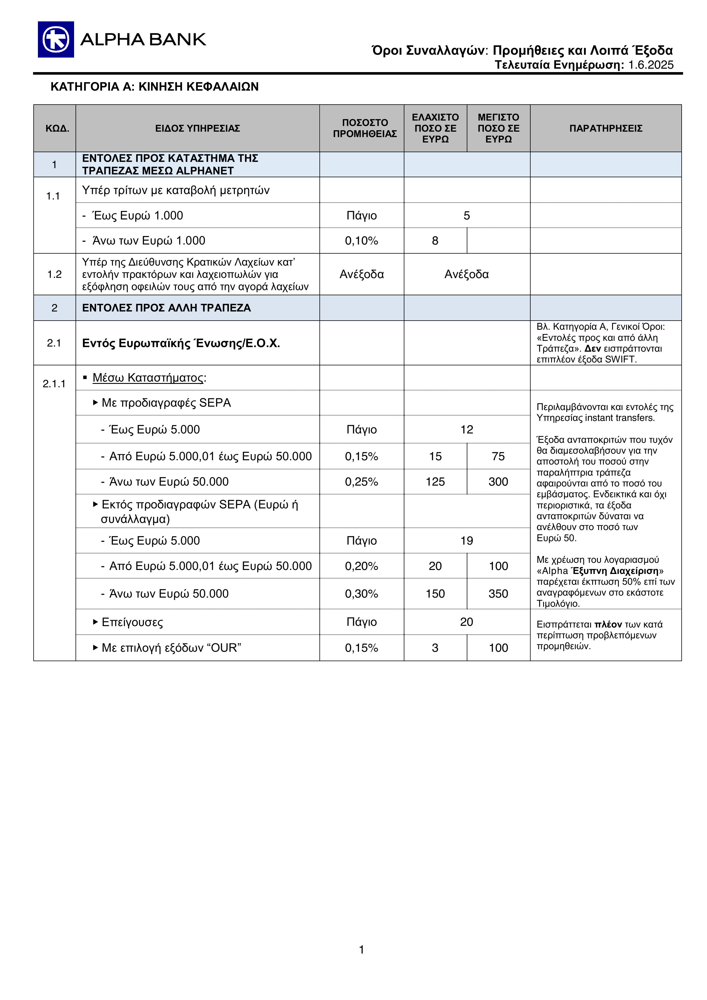

In [88]:
import concurrent.futures
from decimal import Decimal, getcontext

getcontext().prec = 12  # Adjust precision as needed

model_times = {}

# each entry is a touple of cost per 1M input token and cost per 1M output tokens in USDcenters
model_costs = {
    'gemini-2.0-flash-lite': (7.5, 30),
    'gemini-2.0-flash': (10, 40),
    'gemini-2.5-flash-preview-05-20': (15, 60),
    'gpt-4o': (500, 2000),
    'gpt-4o-mini': (60, 240),
    'gpt-4.1-mini': (40, 160),
    'gpt-4.1-nano': (10, 40),
}

models = [
    'gemini-2.0-flash-lite', 'gemini-2.0-flash', 'gemini-2.5-flash-preview-05-20',
    # 'gpt-4o', 'gpt-4o-mini',
    # 'gpt-4.1-mini', 'gpt-4.1-nano'
]
temperatures = [0.2, 0.5, 0.8, 1]  # Example temperatures for OpenAI models


def run_extraction(model, temperature):
    start = time.time()
    if model.startswith('gemini'):
        resp, itoks, otoks = extract_table_from_image_gemini(
            model, temperature, image_bytes.getvalue())
    else:
        resp, itoks, otoks = extract_table_from_image_oai(
            model, temperature, image_bytes.getvalue())
    elapsed = time.time() - start
    cost_basis = model_costs[model]
    input_tokens = Decimal(itoks)
    output_tokens = Decimal(otoks)
    cost_input = (input_tokens * Decimal(cost_basis[0])) / Decimal(1_000_000)
    cost_output = (output_tokens * Decimal(cost_basis[1])) / Decimal(1_000_000)
    cost = cost_input + cost_output
    return model, resp, elapsed, float(cost)


with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = {
        executor.submit(run_extraction, model, temperature): (model, temperature)
        for model in models
        for temperature in temperatures
    }
    for future in concurrent.futures.as_completed(futures):
        model, temperature = futures[future]
        mkey = f"{model}_temp{temperature}"
        model_name, resp, elapsed, cost = future.result()
        last_resp[mkey] = resp
        model_times[mkey] = elapsed
        cost_counts[mkey] = cost

# Create a DataFrame to display model times and a preview of the response
results_df = pd.DataFrame({
    "Model": list(model_times.keys()),
    "Time (s)": [t for t in model_times.values()],
    "Cost ($c)": [cost_counts[m] for m in model_times],
    "Response": [str(last_resp[m]) for m in model_times]

})

display(results_df)
display(image)

In [89]:
import json
# reemove "```json" and "```" from the response
def clean_json_response(response):
	if response.startswith("```json"):
		response = response[len("```json"):].strip()
	if response.endswith("```"):
		response = response[:-len("```")].strip()
	return response

last_resp_j= {}
for key in last_resp:
	last_resp[key] = clean_json_response(last_resp[key])
	last_resp_j[key] = json.loads(last_resp[key])  # Parse the cleaned JSON string

last_resp_j

results_df = pd.DataFrame({
    "Model": list(model_times.keys()),
    "Time (s)": [t for t in model_times.values()],
    "Cost ($)": [cost_counts[m]/100 for m in model_times],
    "Response": [str(last_resp_j[m]) for m in model_times]
})
# sort by model name
results_df.sort_values(by="Model", inplace=True)
display(results_df)
results_df.sort_values(by="Time (s)", inplace=True)
display(results_df)


ValueError: Exceeds the limit (4300 digits) for integer string conversion: value has 7694 digits; use sys.set_int_max_str_digits() to increase the limit

In [104]:
entries = [
	{
		"code": "A",
		"desc": "KINHSH KEFAILAION",
		"entries": [
			{
				"code": "1",
				"desc": "ENTOLES",
				"entries": [
					{
						"code": "1.1",
						"desc": "ENTOLI KINHSHS",
						"entries": [
							{
								"code": "1.1.1",
								"desc": "ENTOLI KINHSHS ME POSO EWS 1000",
							},
							{
								"code": "1.1.2",
								"desc": "ENTOLI KINHSHS ME POSO 1000-5000",
							}
						]
					},
					{
						"code": "1.2",
						"desc": "ENTOLI KINHSHS ME POSO PANO APO 5000",
					}
				]
			}
		]
	}
]

k = list(last_resp.keys())
display(json.loads(last_resp["gemini-2.0-flash_temp0.5"]))

{'bankName': 'ALPHA BANK',
 'lastUpdated': '2025-06-01T00:00:00Z',
 'categories': [{'code': 'A',
   'title': 'ΚΙΝΗΣΗ ΚΕΦΑΛΑΙΩΝ',
   'services': [{'code': '1',
     'description': 'ΕΝΤΟΛΕΣ ΠΡΟΣ ΚΑΤΑΣΤΗΜΑ ΤΗΣ ΤΡΑΠΕΖΑΣ ΜΕΣΩ ALPHANET',
     'feeModel': {'fees': [{'range': {'from': 0.0, 'to': 0.0},
        'feeType': 'fixed',
        'fixedFee': 5.0,
        'currency': 'EUR',
        'note': 'Πάγιο'}]},
     'notes': []},
    {'code': '1.1',
     'description': 'Υπέρ τρίτων με καταβολή μετρητών - Έως Ευρώ 1.000',
     'feeModel': {'fees': [{'range': {'from': 0.0, 'to': 0.0},
        'feeType': 'fixed',
        'fixedFee': 5.0,
        'currency': 'EUR',
        'note': 'Πάγιο'}]},
     'notes': []},
    {'code': '1.1',
     'description': 'Υπέρ τρίτων με καταβολή μετρητών - Άνω των Ευρώ 1.000',
     'feeModel': {'fees': [{'range': {'from': 0.0, 'to': 0.0},
        'feeType': 'percentage',
        'percentage': 0.1,
        'currency': 'EUR'}]},
     'notes': []},
    {'code': '1.2',
     '

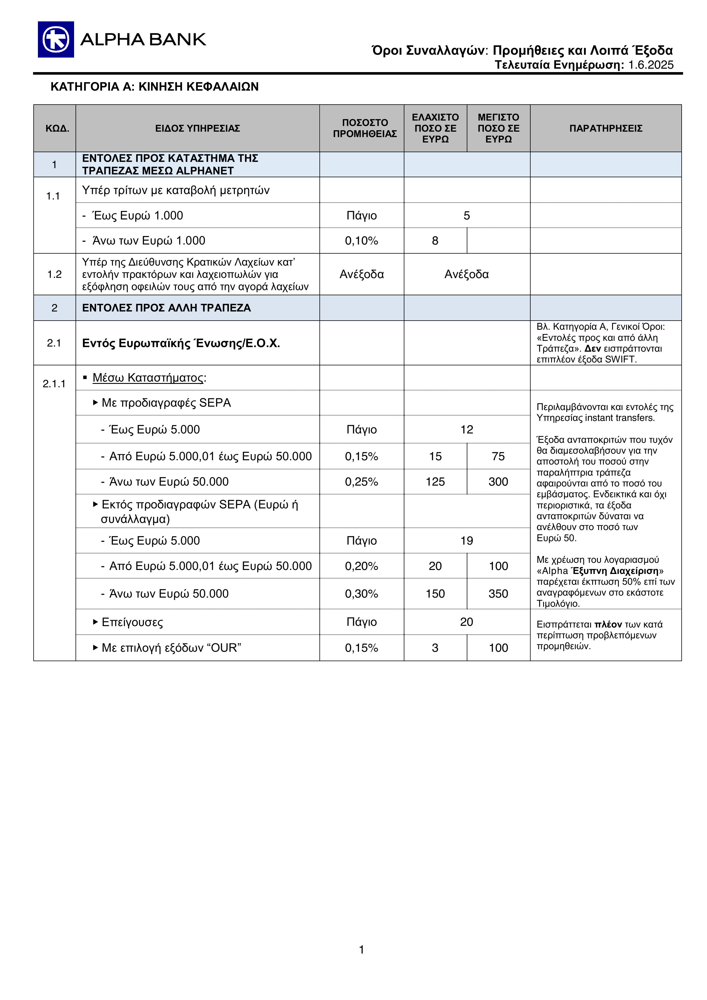

In [72]:
display(image)

Displaying random pages from nbg-loans.pdf:
Page 11:


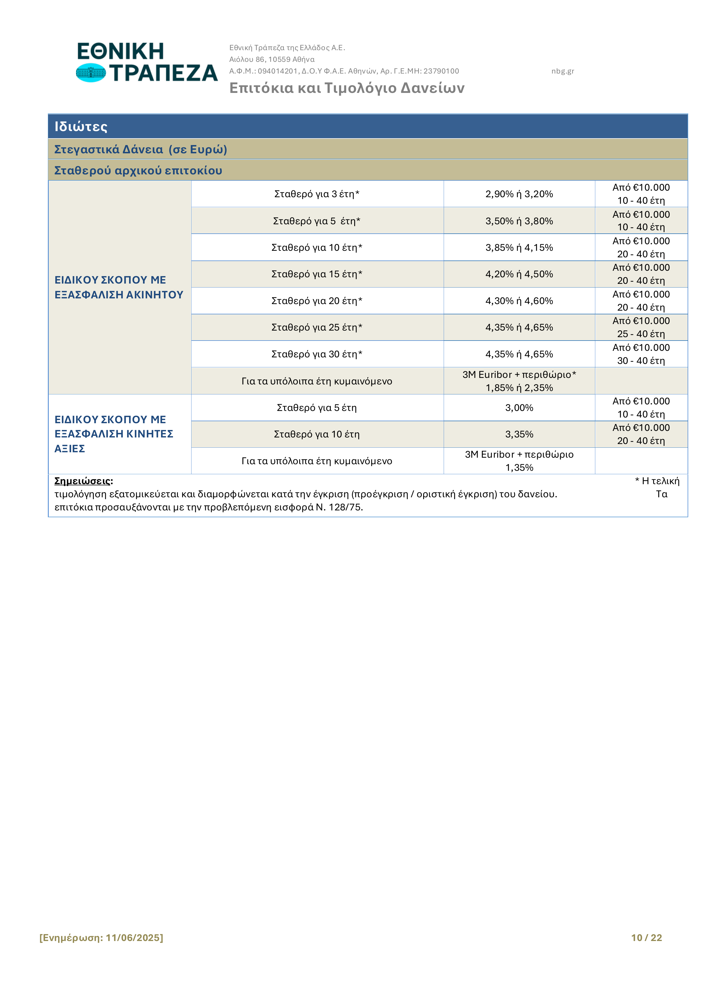



Page 5:


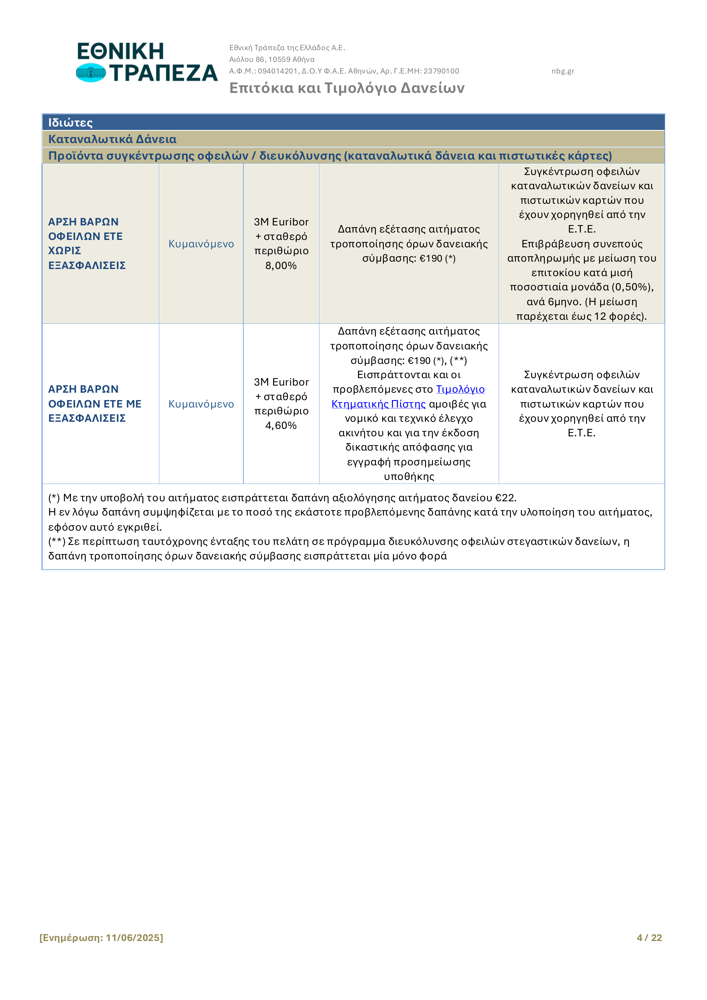



Page 17:


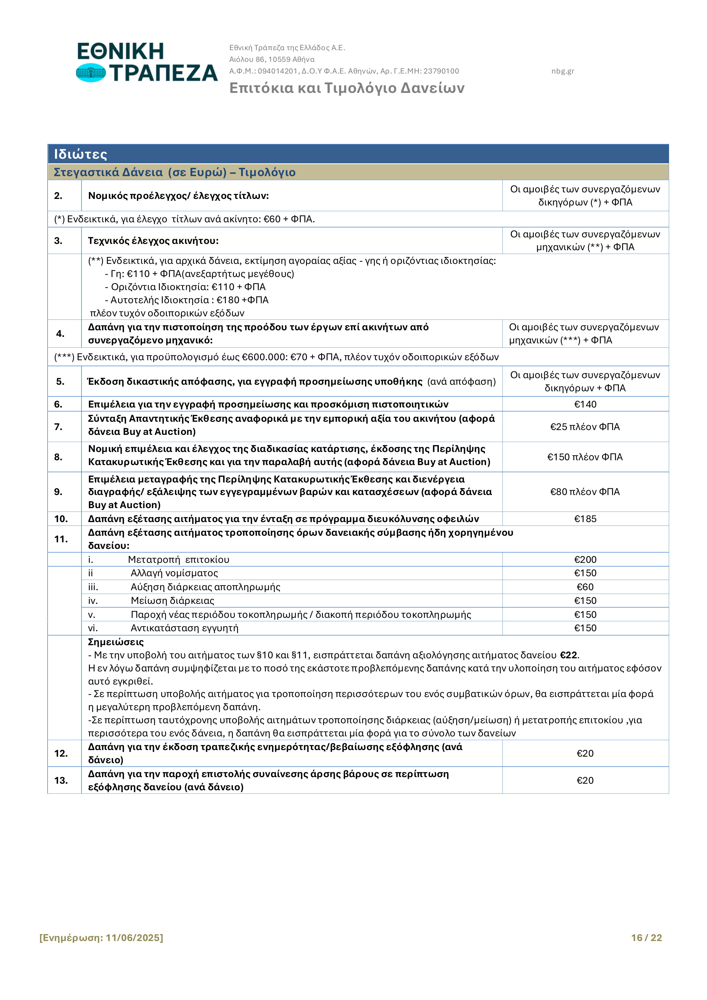



Displaying random pages from eurobank.pdf:
Page 58:


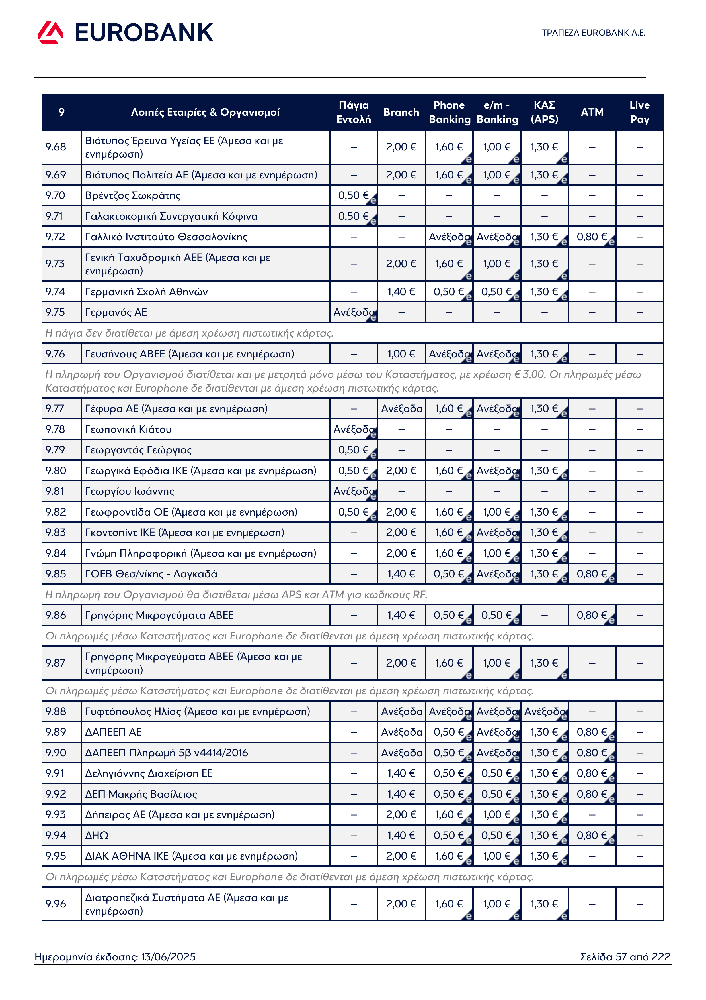



Page 123:


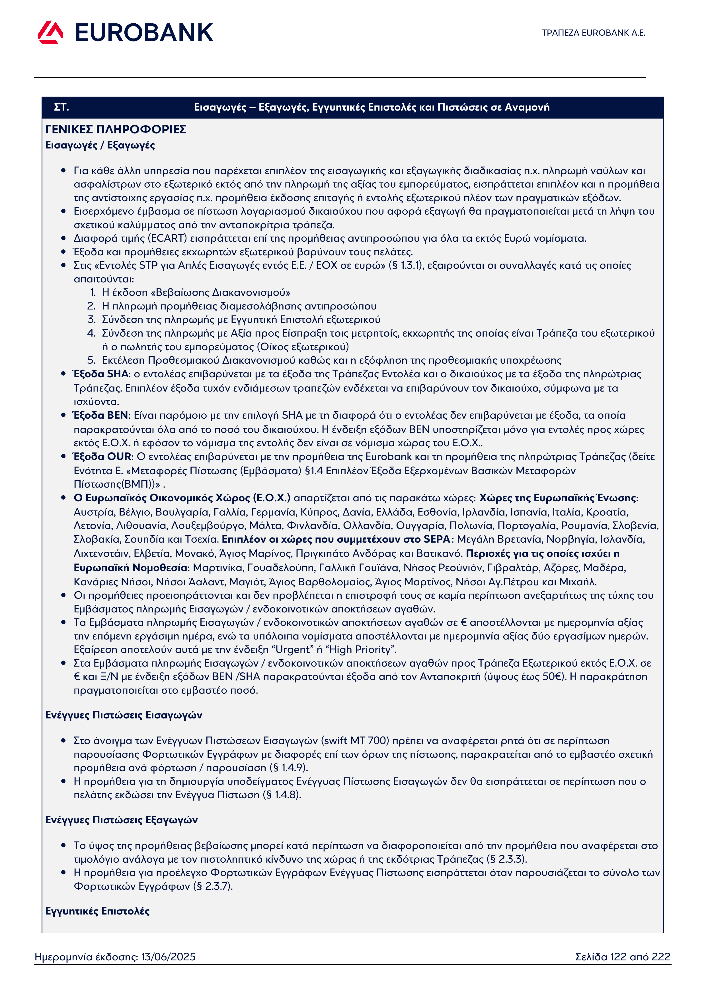



Page 197:


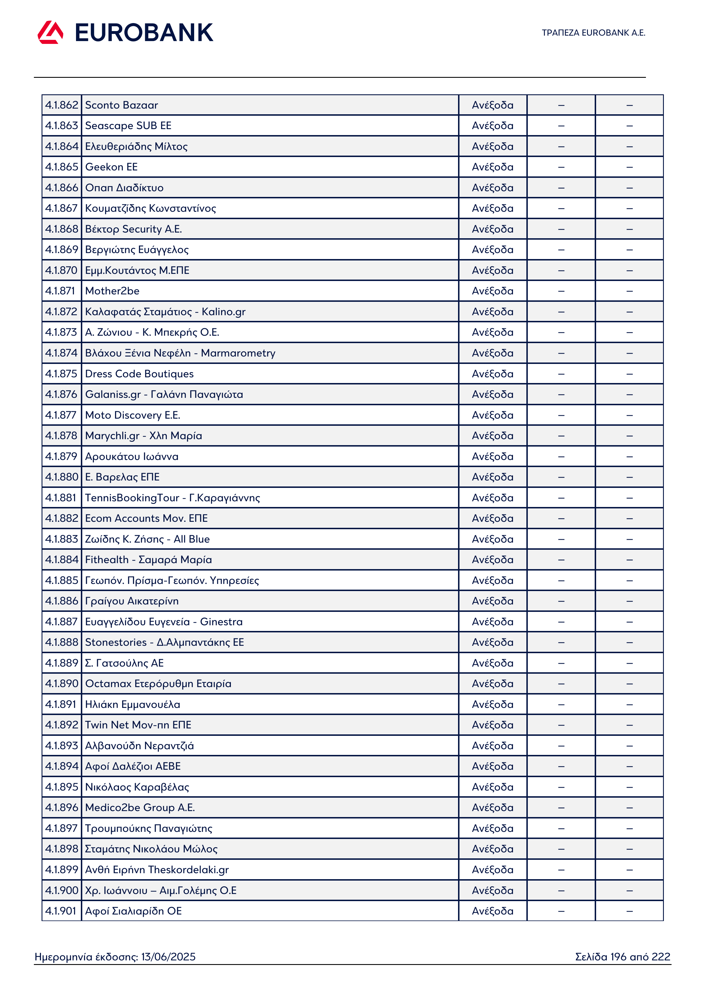



Displaying random pages from piraeus.pdf:
Page 30:


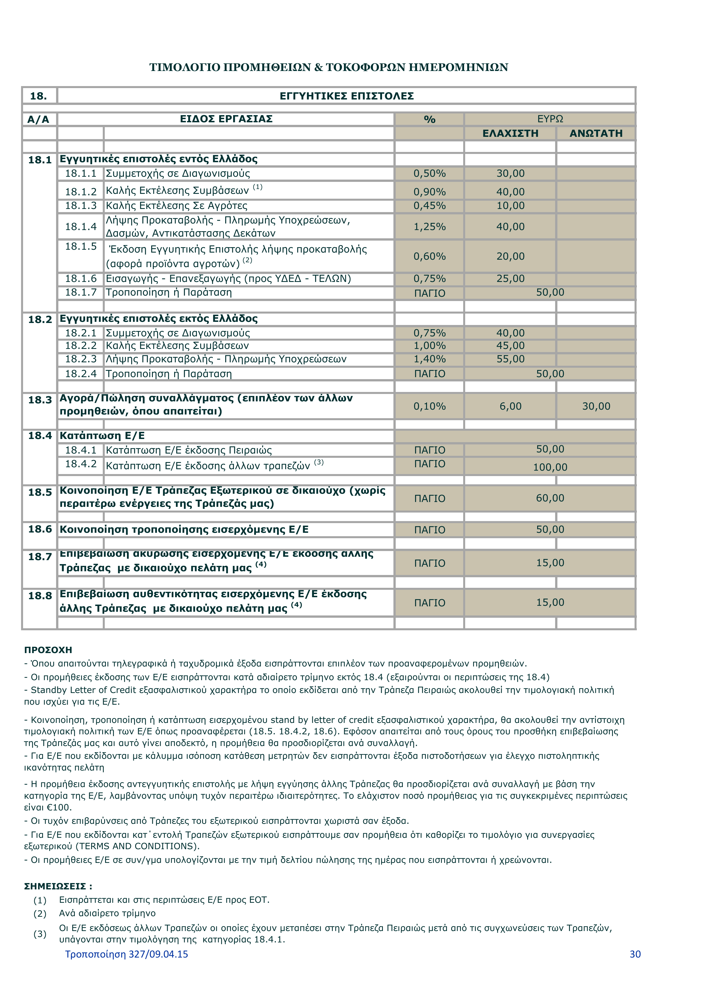



Page 21:


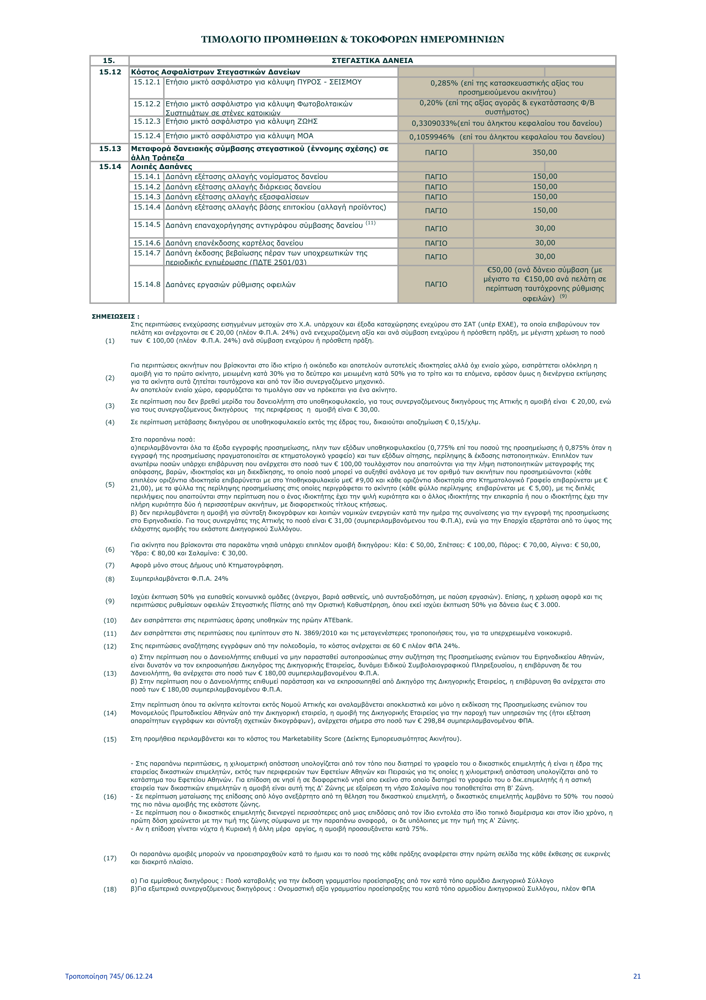



Page 22:


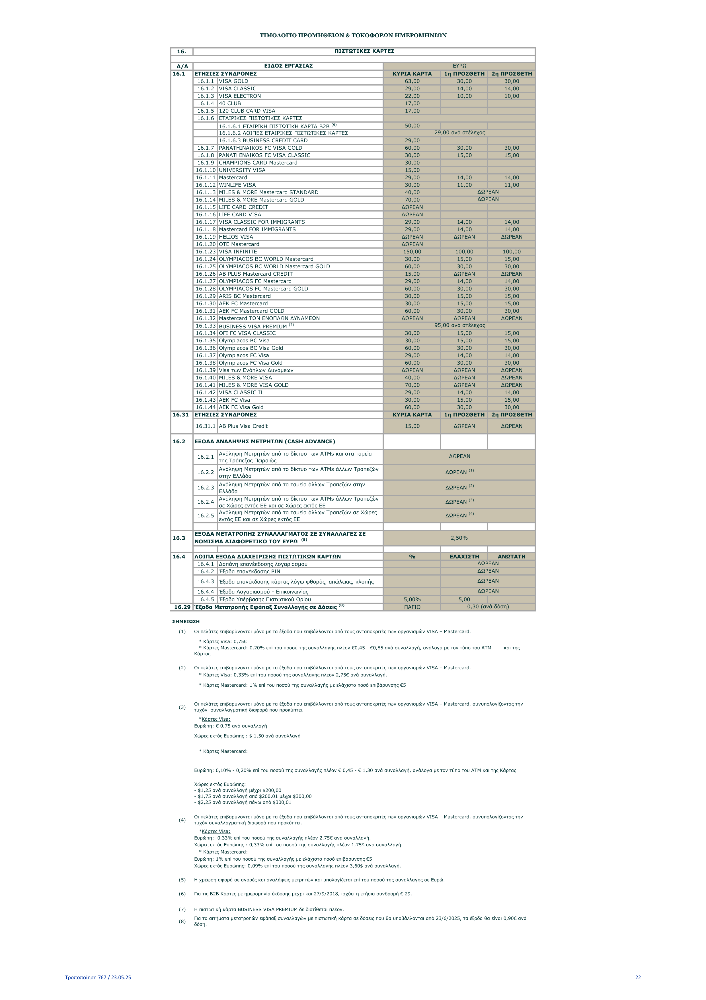



Displaying random pages from alpha.pdf:
Page 34:


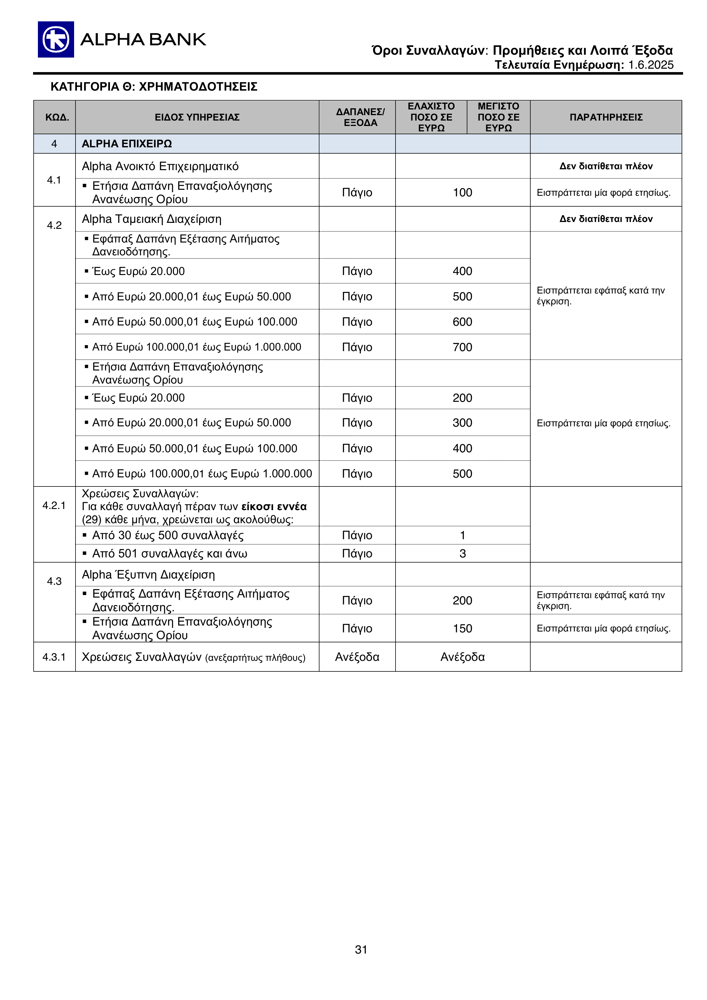



Page 31:


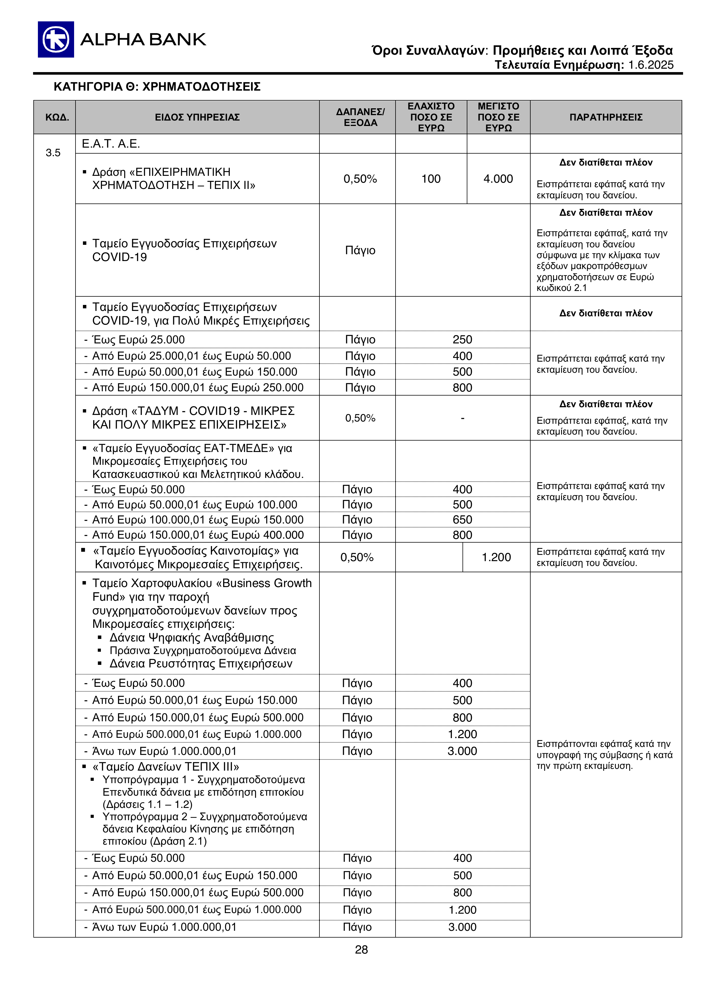



Page 38:


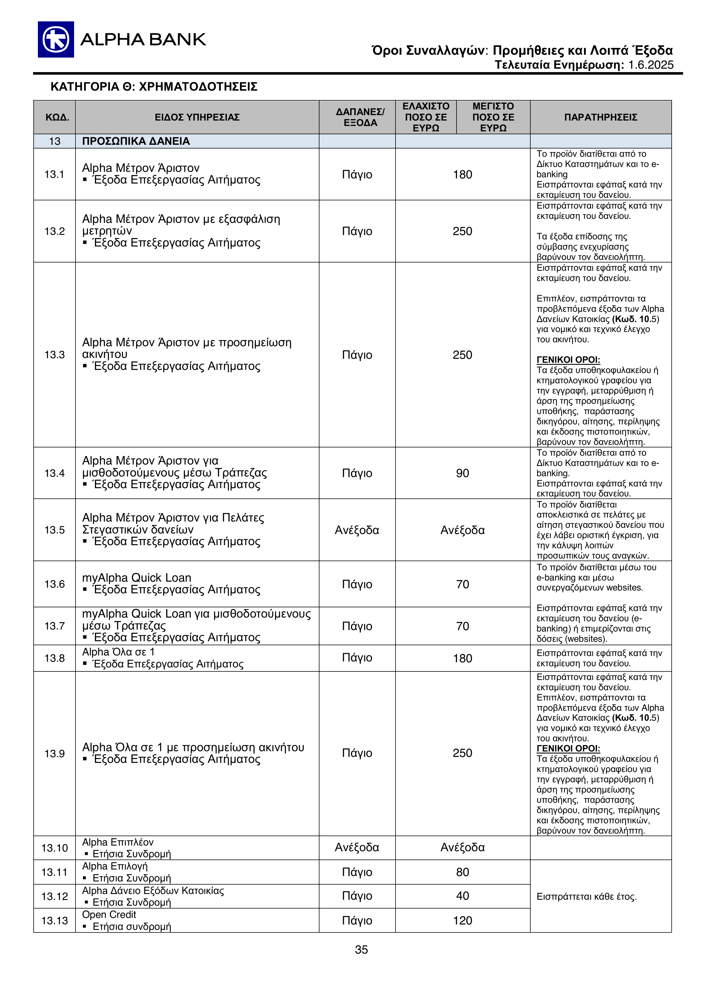



Displaying random pages from nbg-deposits.pdf:


IndexError: list index out of range

In [76]:
# display a random selection of pages from *.pdf
import random
def display_random_pdf_pages(pdf_path, num_pages=3):
	with pdfplumber.open(pdf_path) as pdf:
		total_pages = len(pdf.pages)
		selected_pages = random.sample(range(total_pages), num_pages)
		for page_num in selected_pages:
			page = convert_from_path(pdf_path, dpi=dpi, first_page=page_num, last_page=page_num)[0]
			print(f"Page {page_num + 1}:")
			display(page)
			print("\n")
# for all pdfs in the current directory
pdf_files = [f for f in os.listdir('.') if f.endswith('.pdf')]
for pdf_file in pdf_files:
	print(f"Displaying random pages from {pdf_file}:")
	display_random_pdf_pages(pdf_file, num_pages=3)